
#### Speech Signal Modulation and Demodulation Project

#### **Overview:**  
#### This notebook reads three audio files, resamples them to a common sampling frequency (250,000 Hz), and processes them so that they all have the same length. The signals are then modulated with carrier signals and later demodulated (with standard, phase-shifted, and frequency-shifted carriers). The modulated and demodulated signals are plotted and saved in the "Output_signals" folder.

#### **Folders:**
#### - **Input:** `signals` (place your .wav files here)
#### - **Output:** `Output_signals` (demodulated .wav files will be saved here)


In [1]:
pip install numpy scipy librosa soundfile matplotlib ipython

Defaulting to user installation because normal site-packages is not writeable
  Using cached librosa-0.11.0-py3-none-any.whl (260 kB)
  Using cached soundfile-0.13.1-py2.py3-none-win_amd64.whl (1.0 MB)
  Using cached cffi-1.17.1-cp310-cp310-win_amd64.whl (181 kB)
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
from scipy.signal import butter, filtfilt
import numpy.fft as fft
from scipy import signal

### 1. Read Audio Files and Resample
#### Read the audio files from the "signals" folder and resample them to 250000 Hz.

In [3]:
# %%
# Define new sampling frequency
FsNew = 250000

# Read audio files (assuming mono or stereo)
signal_1, sr1 = librosa.load('signals/ziad.wav', sr=None)
signal_2, sr2 = librosa.load('signals/esoo.wav', sr=None)
signal_3, sr3 = librosa.load('signals/mohey.wav', sr=None)

# Resample signals using librosa.resample
signal_1 = librosa.resample(signal_1, orig_sr=sr1, target_sr=FsNew)
signal_2 = librosa.resample(signal_2, orig_sr=sr2, target_sr=FsNew)
signal_3 = librosa.resample(signal_3, orig_sr=sr3, target_sr=FsNew)

# Update common sampling frequency variable
frequency_sampling = FsNew


### 2. Sum Channels (if stereo) and Equalize Signal Lengths
#### If signals have more than one channel, we sum the channels (to make them mono). Then, we pad signals with zeros so that they all have the same length.


In [4]:
# (If signals were read as stereo, they would be 2D arrays.
# Here we check and sum channels if necessary.)
def ensure_mono(signal):
    if signal.ndim > 1:
        return np.sum(signal, axis=0)
    return signal

signal_1 = ensure_mono(signal_1)
signal_2 = ensure_mono(signal_2)
signal_3 = ensure_mono(signal_3)

# Determine lengths and pad signals to have the same length
lengths = [len(signal_1), len(signal_2), len(signal_3)]
N = max(lengths)

signal_1 = np.pad(signal_1, (0, N - len(signal_1)), 'constant')
signal_2 = np.pad(signal_2, (0, N - len(signal_2)), 'constant')
signal_3 = np.pad(signal_3, (0, N - len(signal_3)), 'constant')


### 3. Time and Frequency Axes, FFT, and Phase
#### We compute the time vector, frequency vector, FFTs, and the unwrapped phase of the signals.


In [5]:
# %%
# Time axis and frequency axis
t = np.linspace(0, N / frequency_sampling, N)
frequency_d = frequency_sampling / 2
frequency = np.linspace(-frequency_d, frequency_d - frequency_sampling/N, N)

# Compute FFT and phase for each signal
signal_1_fft = fft.fftshift(fft.fft(signal_1))
signal_2_fft = fft.fftshift(fft.fft(signal_2))
signal_3_fft = fft.fftshift(fft.fft(signal_3))

phase_signal_1 = np.unwrap(np.angle(signal_1_fft))
phase_signal_2 = np.unwrap(np.angle(signal_2_fft))
phase_signal_3 = np.unwrap(np.angle(signal_3_fft))


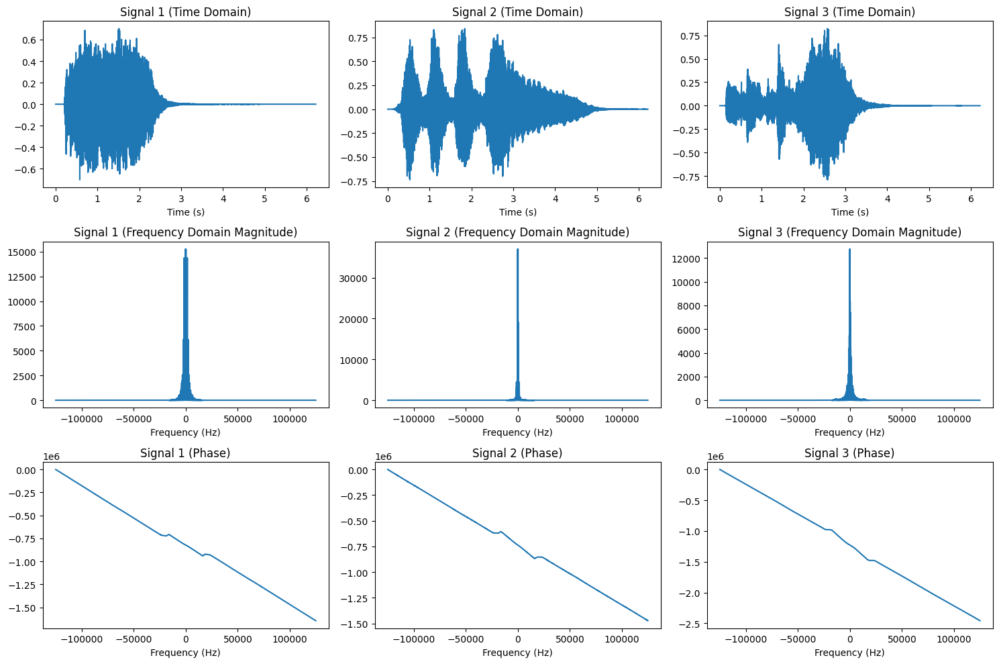

In [6]:

# Assuming signal_1, signal_2, signal_3, t, frequency, 
# phase_signal_1, phase_signal_2, phase_signal_3, and N are already defined

plt.figure(figsize=(15, 10))  # Adjust figure size as needed

# Time-domain plots
plt.subplot(3, 3, 1)
plt.plot(t, signal_1)
plt.title('Signal 1 (Time Domain)')
plt.xlabel('Time (s)')

plt.subplot(3, 3, 2)
plt.plot(t, signal_2)
plt.title('Signal 2 (Time Domain)')
plt.xlabel('Time (s)')

plt.subplot(3, 3, 3)
plt.plot(t, signal_3)
plt.title('Signal 3 (Time Domain)')
plt.xlabel('Time (s)')


# Frequency-domain magnitude plots
plt.subplot(3, 3, 4)
plt.plot(frequency, np.abs(signal_1_fft))
plt.title('Signal 1 (Frequency Domain Magnitude)')
plt.xlabel('Frequency (Hz)')

plt.subplot(3, 3, 5)
plt.plot(frequency, np.abs(signal_2_fft))
plt.title('Signal 2 (Frequency Domain Magnitude)')
plt.xlabel('Frequency (Hz)')

plt.subplot(3, 3, 6)
plt.plot(frequency, np.abs(signal_3_fft))
plt.title('Signal 3 (Frequency Domain Magnitude)')
plt.xlabel('Frequency (Hz)')


# Phase plots
plt.subplot(3, 3, 7)
plt.plot(frequency, phase_signal_1)
plt.title('Signal 1 (Phase)')
plt.xlabel('Frequency (Hz)')

plt.subplot(3, 3, 8)
plt.plot(frequency, phase_signal_2)
plt.title('Signal 2 (Phase)')
plt.xlabel('Frequency (Hz)')

plt.subplot(3, 3, 9)
plt.plot(frequency, phase_signal_3)
plt.title('Signal 3 (Phase)')
plt.xlabel('Frequency (Hz)')

plt.tight_layout()  # Adjust subplot parameters for a tight layout
plt.show()


### 4. Carrier Generation
#### Carrier frequencies are set as follows:

#### - **Carrier 1:** 50,000 Hz (for signal 1)
#### - **Carrier 2:** 100,000 Hz (for signal 2 and 3)

#### We generate the carriers in the time domain and also compute their phases.


In [7]:
# Carrier frequencies
Carrier_frequency_1 = 50000
Carrier_frequency_2 = 2 * 50000

# Angular frequencies
WC_1 = 2 * np.pi * Carrier_frequency_1
WC_2 = 2 * np.pi * Carrier_frequency_2

# Generate carrier signals in time domain
carrier_signal_1 = np.cos(WC_1 * t)
carrier_signal_2 = np.cos(WC_2 * t)
carrier_signal_3 = np.sin(WC_2 * t)

# Compute FFT and unwrapped phase for carriers
phase_carrier_signal_1 = np.unwrap(np.angle(fft.fftshift(fft.fft(carrier_signal_1))))
phase_carrier_signal_2 = np.unwrap(np.angle(fft.fftshift(fft.fft(carrier_signal_2))))
phase_carrier_signal_3 = np.unwrap(np.angle(fft.fftshift(fft.fft(carrier_signal_3))))


### 5. Modulation
#### Multiply each signal with its respective carrier and compute the FFT and phase of the modulated signals.
#### Finally, the modulated signals are summed to create a combined modulated signal.


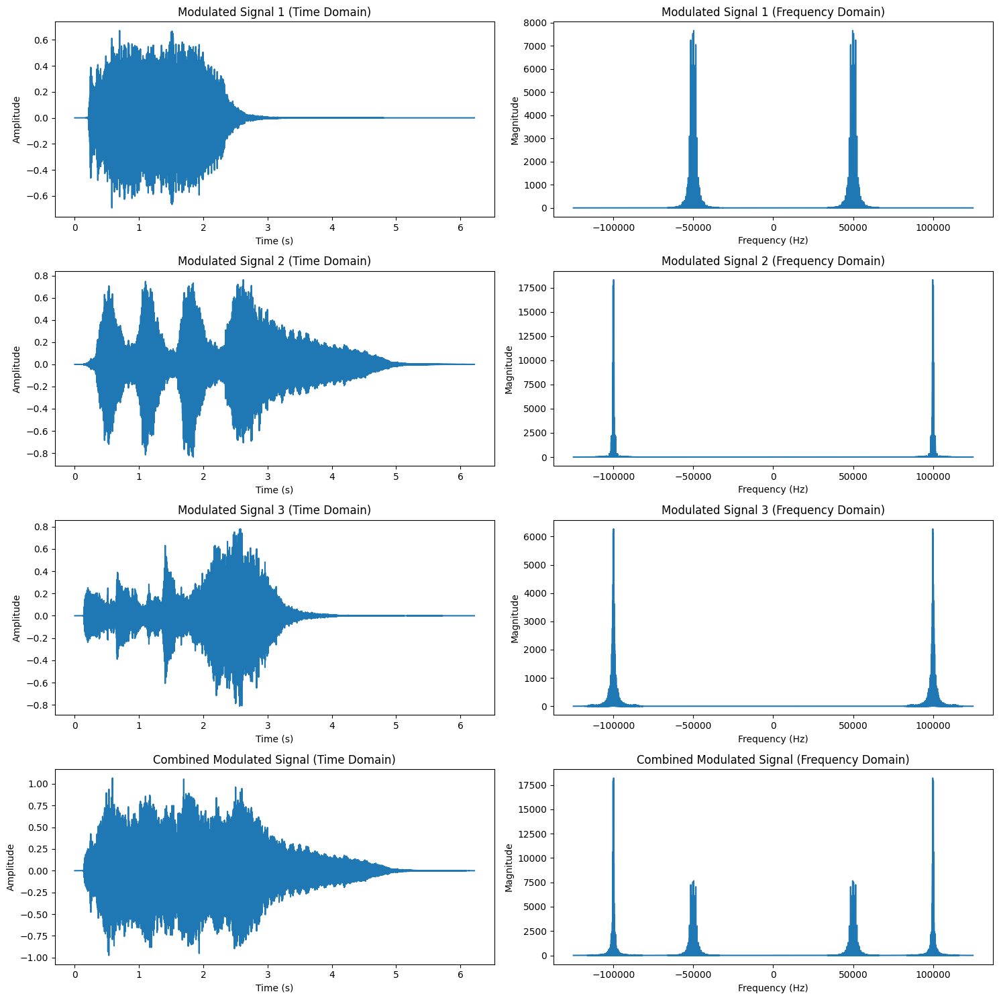

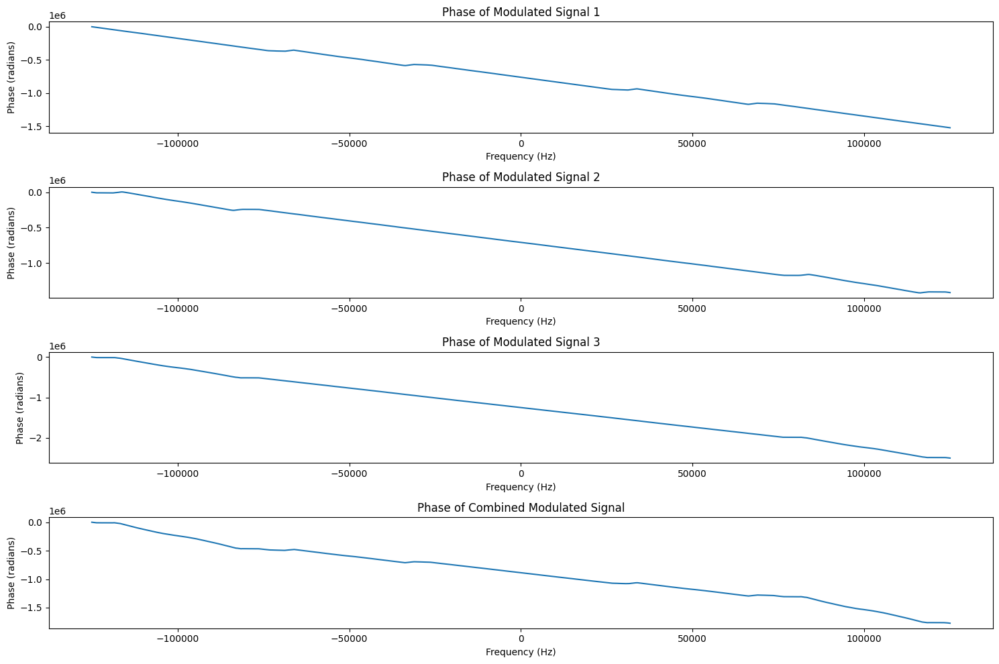

In [8]:
# Modulate the signals (elementwise multiplication)
modulatedSignal_t1 = signal_1 * carrier_signal_1
modulatedSignal_t2 = signal_2 * carrier_signal_2
modulatedSignal_t3 = signal_3 * carrier_signal_3

# FFT and phase of modulated signals
modulated_signal_f1 = fft.fftshift(fft.fft(modulatedSignal_t1))
modulated_signal_f2 = fft.fftshift(fft.fft(modulatedSignal_t2))
modulated_signal_f3 = fft.fftshift(fft.fft(modulatedSignal_t3))

phase_modulation_1 = np.unwrap(np.angle(modulated_signal_f1))
phase_modulation_2 = np.unwrap(np.angle(modulated_signal_f2))
phase_modulation_3 = np.unwrap(np.angle(modulated_signal_f3))

# Sum modulated signals
Modulated_Signal = modulatedSignal_t1 + modulatedSignal_t2 + modulatedSignal_t3
Modulated_Signal_f = fft.fftshift(fft.fft(Modulated_Signal))
phase_mod = np.unwrap(np.angle(Modulated_Signal_f))


# Plot the modulated signals
plt.figure(figsize=(15, 15))

# Modulated Signal 1
plt.subplot(4, 2, 1)
plt.plot(t, modulatedSignal_t1)
plt.title("Modulated Signal 1 (Time Domain)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")

plt.subplot(4, 2, 2)
plt.plot(frequency, np.abs(modulated_signal_f1))
plt.title("Modulated Signal 1 (Frequency Domain)")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")

# Modulated Signal 2
plt.subplot(4, 2, 3)
plt.plot(t, modulatedSignal_t2)
plt.title("Modulated Signal 2 (Time Domain)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")

plt.subplot(4, 2, 4)
plt.plot(frequency, np.abs(modulated_signal_f2))
plt.title("Modulated Signal 2 (Frequency Domain)")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")

# Modulated Signal 3
plt.subplot(4, 2, 5)
plt.plot(t, modulatedSignal_t3)
plt.title("Modulated Signal 3 (Time Domain)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")

plt.subplot(4, 2, 6)
plt.plot(frequency, np.abs(modulated_signal_f3))
plt.title("Modulated Signal 3 (Frequency Domain)")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")

# Combined Modulated Signal
plt.subplot(4, 2, 7)
plt.plot(t, Modulated_Signal)
plt.title("Combined Modulated Signal (Time Domain)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")

plt.subplot(4, 2, 8)
plt.plot(frequency, np.abs(Modulated_Signal_f))
plt.title("Combined Modulated Signal (Frequency Domain)")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")

plt.tight_layout()
plt.show()

# Plot the phases
plt.figure(figsize=(15, 10))

# Phase of Modulated Signal 1
plt.subplot(4, 1, 1)
plt.plot(frequency, phase_modulation_1)
plt.title("Phase of Modulated Signal 1")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Phase (radians)")

# Phase of Modulated Signal 2
plt.subplot(4, 1, 2)
plt.plot(frequency, phase_modulation_2)
plt.title("Phase of Modulated Signal 2")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Phase (radians)")

# Phase of Modulated Signal 3
plt.subplot(4, 1, 3)
plt.plot(frequency, phase_modulation_3)
plt.title("Phase of Modulated Signal 3")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Phase (radians)")

# Phase of Combined Modulated Signal
plt.subplot(4, 1, 4)
plt.plot(frequency, phase_mod)
plt.title("Phase of Combined Modulated Signal")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Phase (radians)")

plt.tight_layout()
plt.show()

### 6. Utility Functions: Plotting, Lowpass Filter, and Demodulation
#### These functions handle plotting, filtering, and synchronous demodulation.


In [9]:
def plot_signal(time_axis, freq_axis, phase, time_signal, freq_signal, figure_num, title_str):
    plt.figure(figure_num, figsize=(10, 8))
    
    plt.subplot(3, 1, 1)
    plt.plot(time_axis, time_signal)
    plt.xlabel('Time (s)')
    plt.title(f'{title_str} in Time Domain')
    
    plt.subplot(3, 1, 2)
    plt.plot(freq_axis, freq_signal)
    plt.xlabel('Frequency (Hz)')
    plt.title(f'{title_str} in Frequency Domain')
    
    plt.subplot(3, 1, 3)
    plt.plot(freq_axis, phase)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase')
    plt.title(f'{title_str} Phase')
    
    plt.tight_layout()
    plt.show()



# Bandpass cutoff frequencies for demodulation
frequency_BandPass = 24000
frequency_BandPass2 = 24000


def lowpass_filter(signal, cutoff, fs, order=4):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return filtfilt(b, a, signal)

def demodulation(signal_modulation, cutoff_freq, out_name, carrier_signal, fs, figure_num, time_array):
    # Multiply by carrier (synchronous demodulation) and scale by 2
    demodulated_signal = 2 * (signal_modulation * carrier_signal)
    # Apply lowpass filter
    lpf_signal = lowpass_filter(demodulated_signal, cutoff_freq, fs)
    
    # FFT of the demodulated signal
    fft_signal = fft.fftshift(fft.fft(lpf_signal))
    N_fft = len(fft_signal) // 2
    frequency_vec = np.linspace(-N_fft, N_fft - 1, len(fft_signal))
    
    # Unwrap phase
    phase_signal = np.unwrap(np.angle(fft_signal))
    
    # Plot the demodulated signal
    plot_signal(time_array, frequency_vec, phase_signal, lpf_signal, np.abs(fft_signal), figure_num, out_name)
    
    # Write the output .wav file to "Output_signals" folder
    sf.write(f'Output_signals/{out_name}.wav', lpf_signal, fs)
    return lpf_signal

### 7. Carrier Generation Functions for Phase and Frequency Shifts
#### These functions generate carriers with a specified phase shift or with a frequency offset.


In [10]:
def CarriersPhase(freq1, freq2, phase_deg, time_array):
    phase_rad = np.deg2rad(phase_deg)
    carrier_1 = np.cos((2 * np.pi * freq1 * time_array) + phase_rad)
    carrier_2 = np.cos((2 * np.pi * freq2 * time_array) + phase_rad)
    carrier_3 = np.sin((2 * np.pi * freq2 * time_array) + phase_rad)
    return np.array([carrier_1, carrier_2, carrier_3])

def CarriersDifferentFc(freq1, freq2, freq_shift, time_array):
    carrier_1 = np.cos(2 * np.pi * (freq1 + freq_shift) * time_array)
    carrier_2 = np.cos(2 * np.pi * (freq2 + freq_shift) * time_array)
    carrier_3 = np.sin(2 * np.pi * (freq2 + freq_shift) * time_array)
    return np.array([carrier_1, carrier_2, carrier_3])

### 8. Synchronous Demodulation (Standard)
#### Perform synchronous demodulation using the original carriers.
#### Output files are saved as "Out_1.wav", "Out_2.wav", and "Out_3.wav" in the "Output_signals" folder.


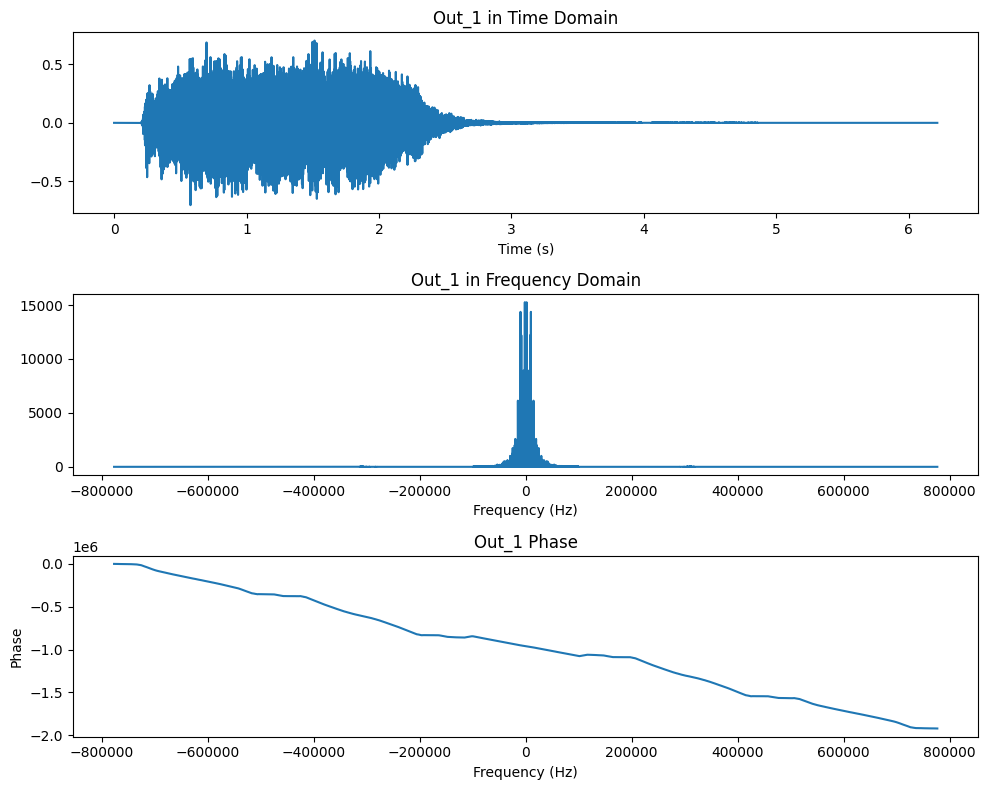

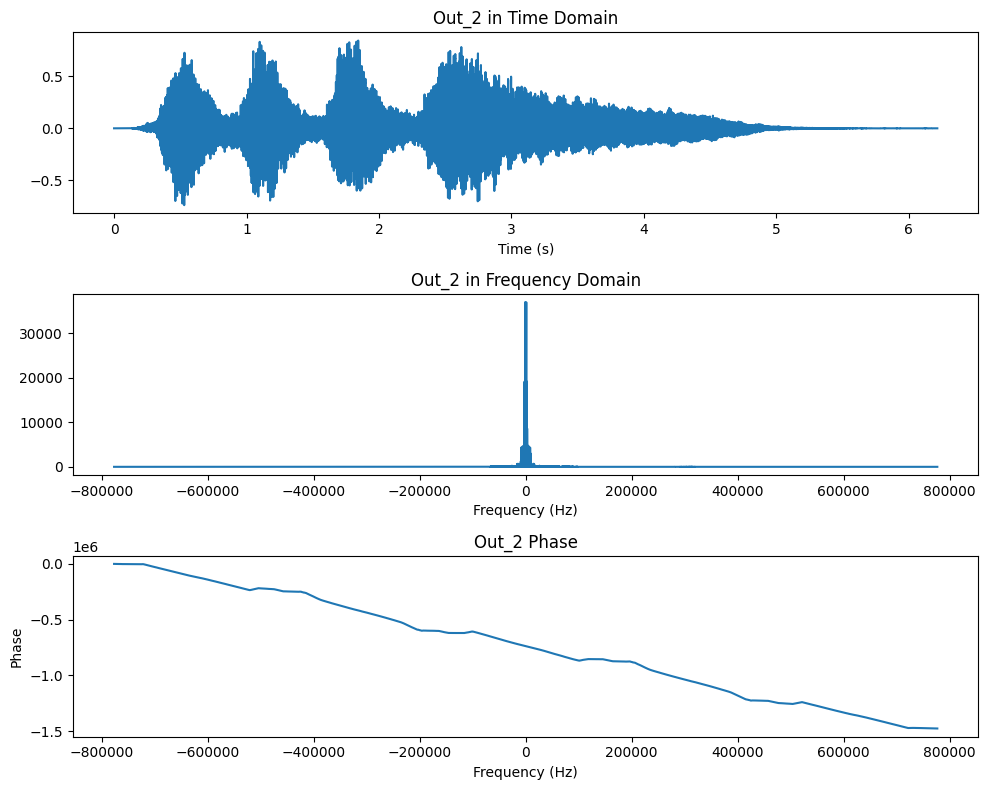

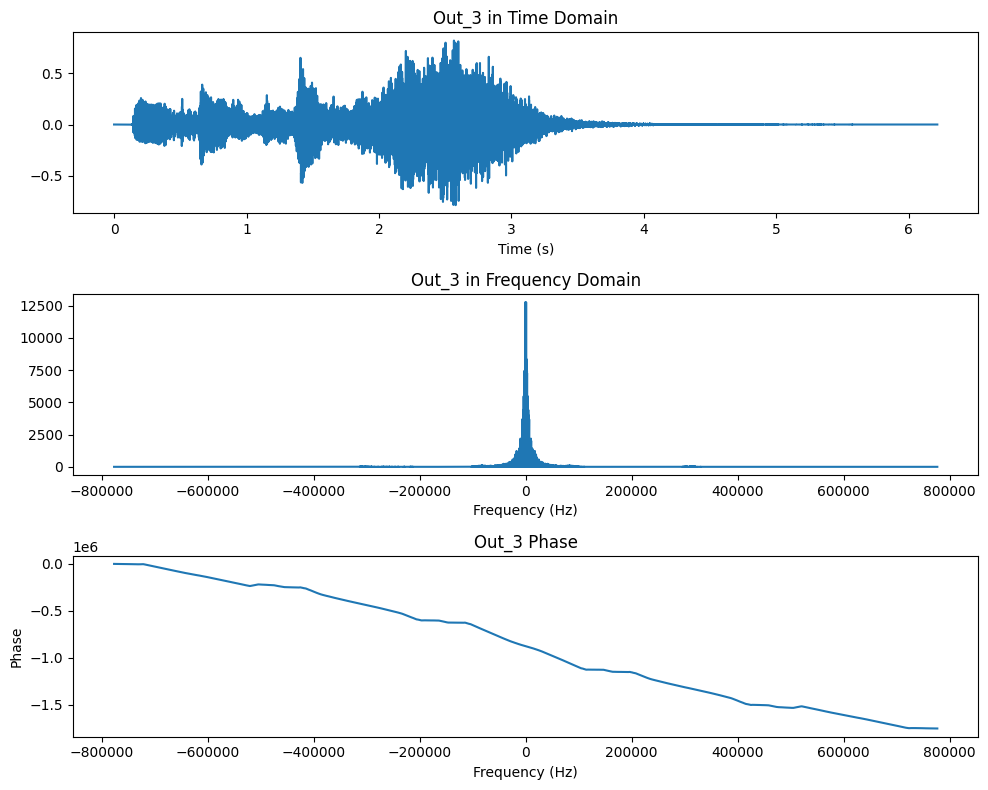

In [11]:
FileNames = ["Out_1", "Out_2", "Out_3"]
Carriers = np.array([carrier_signal_1, carrier_signal_2, carrier_signal_3])

for i in range(3):
    cutoff = frequency_BandPass if i == 0 else frequency_BandPass2
    demodulation(Modulated_Signal, cutoff, FileNames[i], Carriers[i], frequency_sampling, i+6, t)


### 9. Demodulation with Phase Shifts
#### Perform demodulation using carriers with phase shifts of 10°, 30°, and 90°.

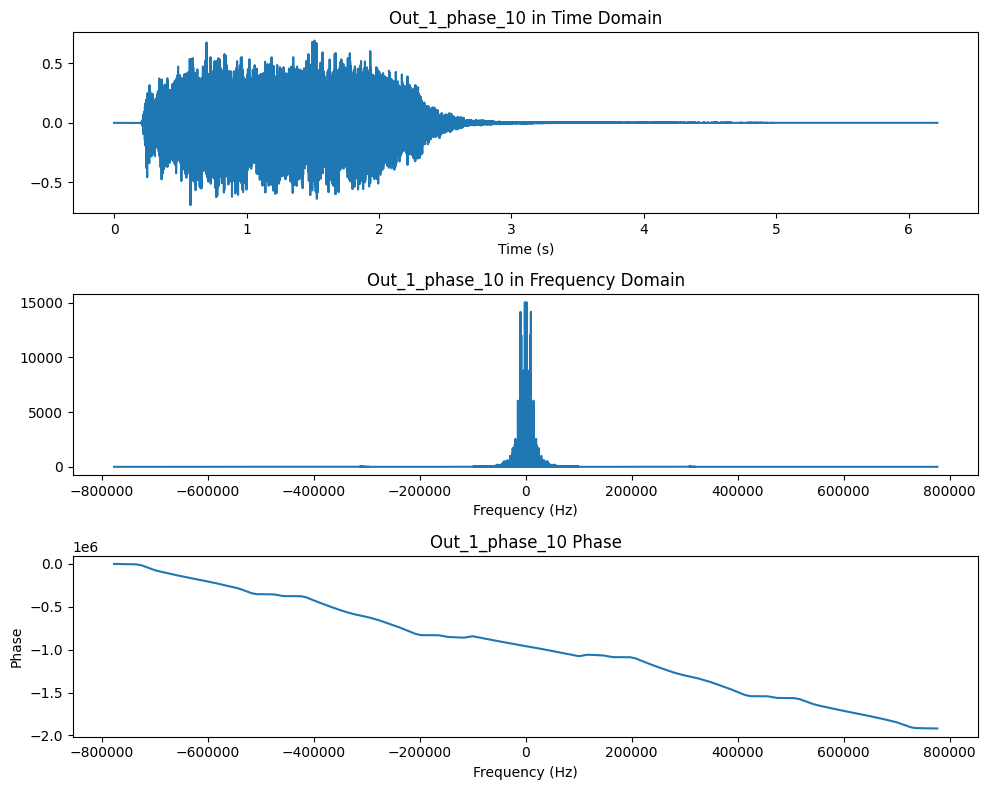

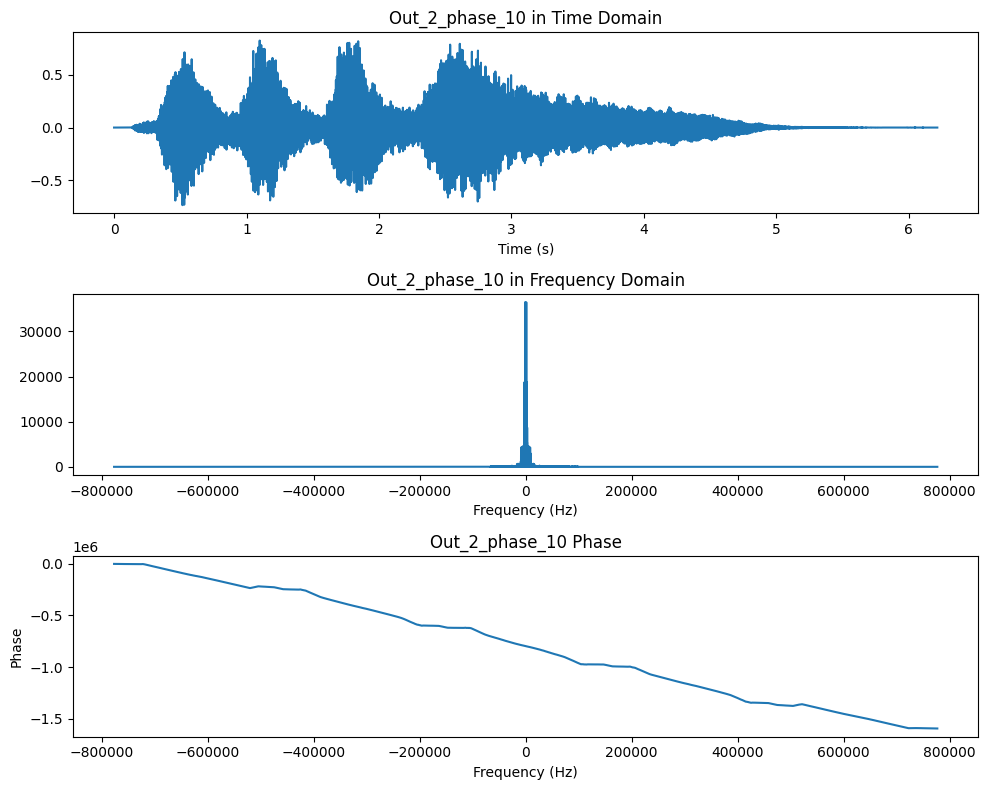

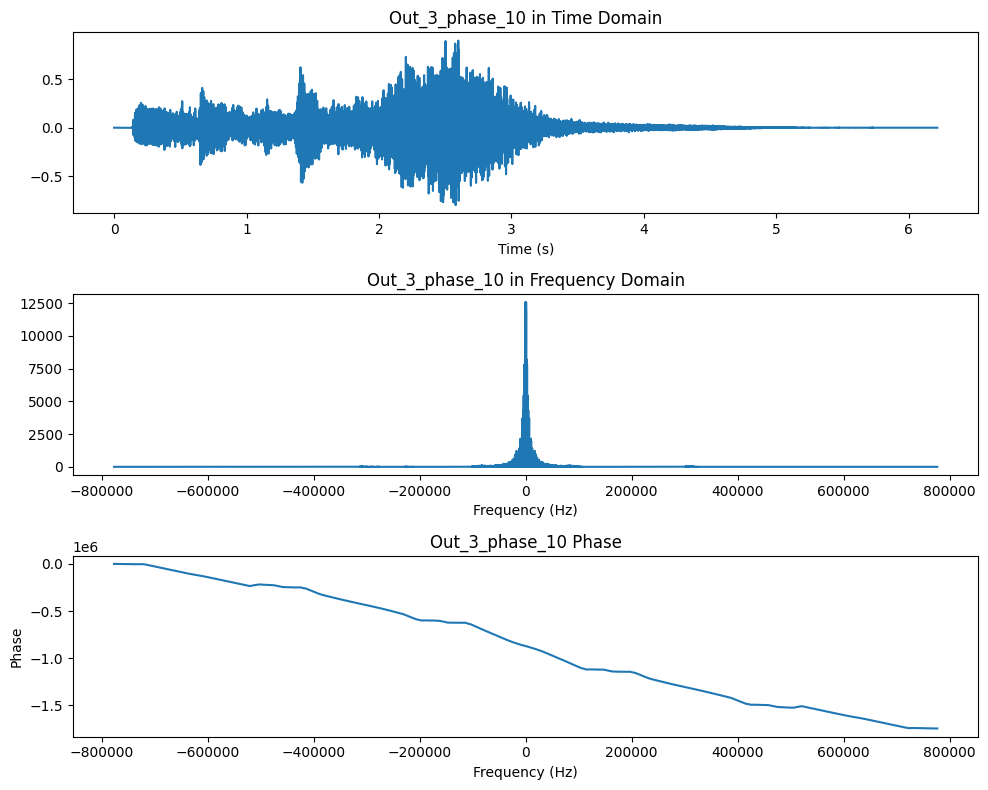

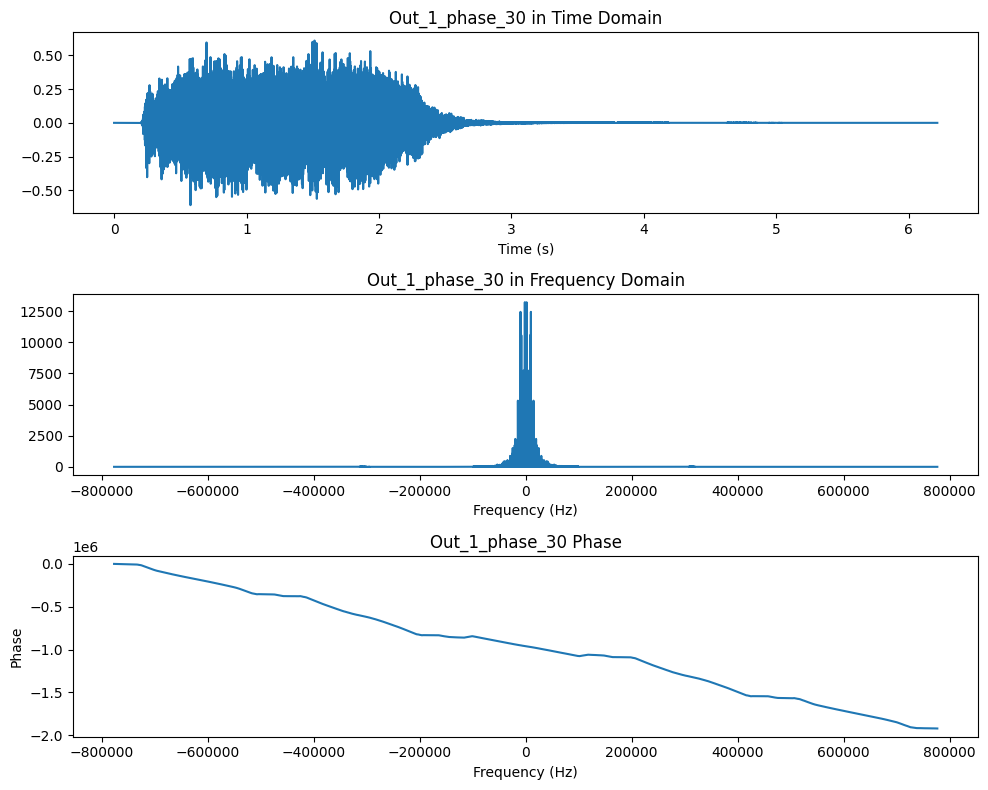

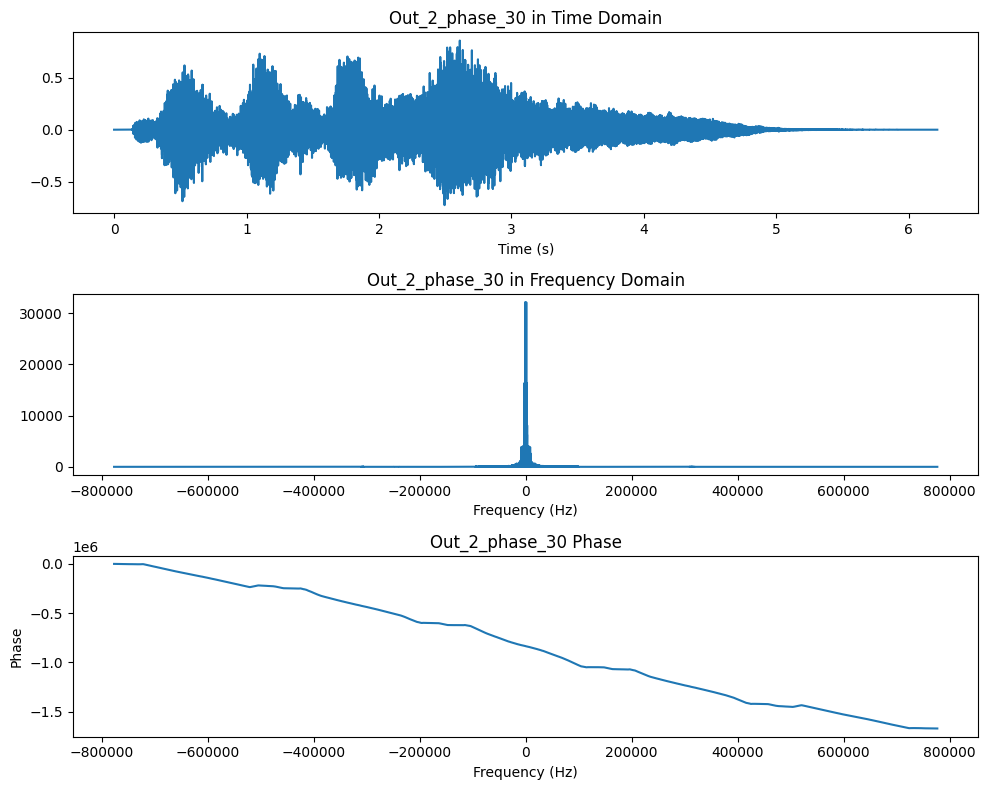

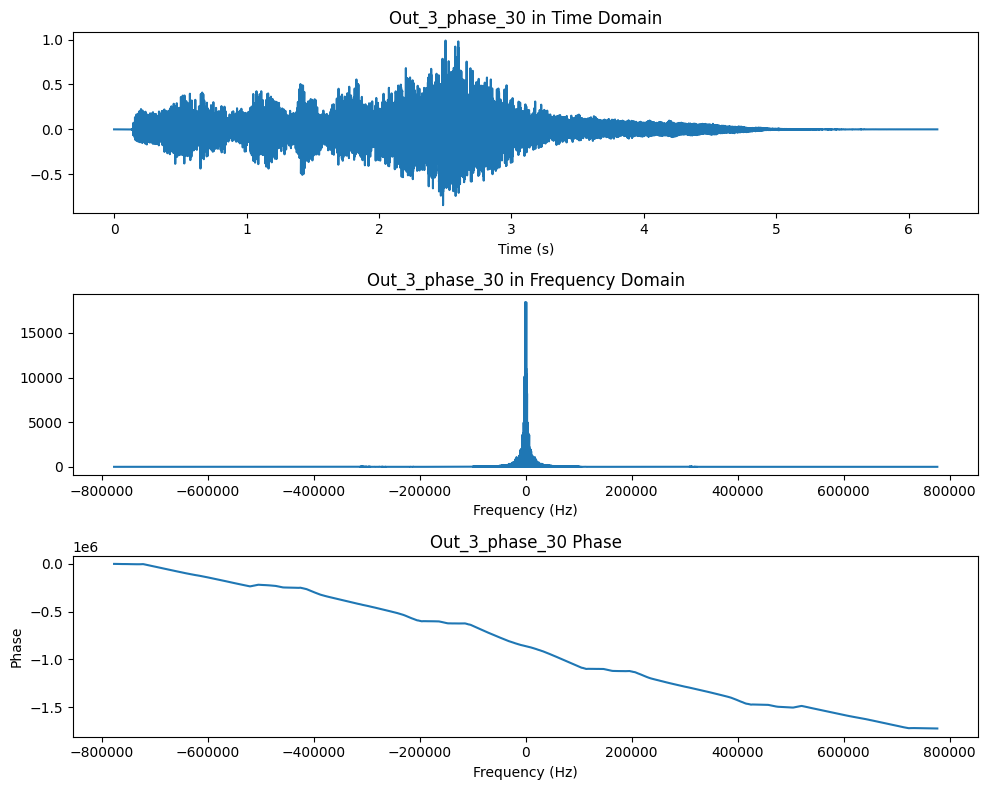

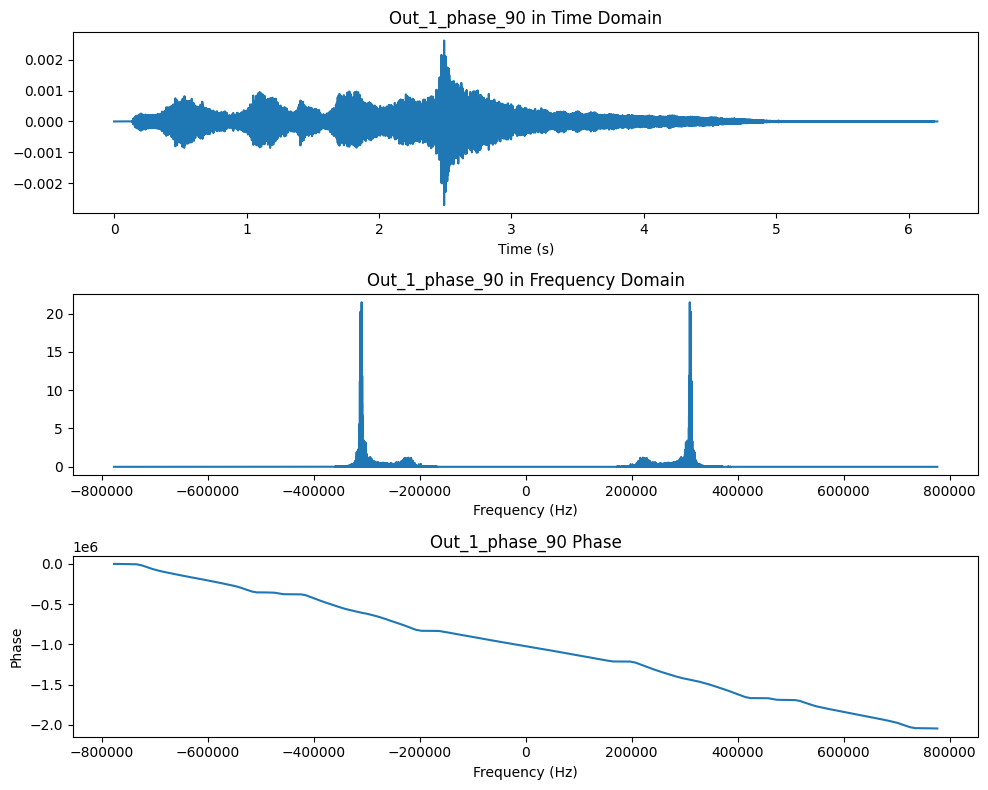

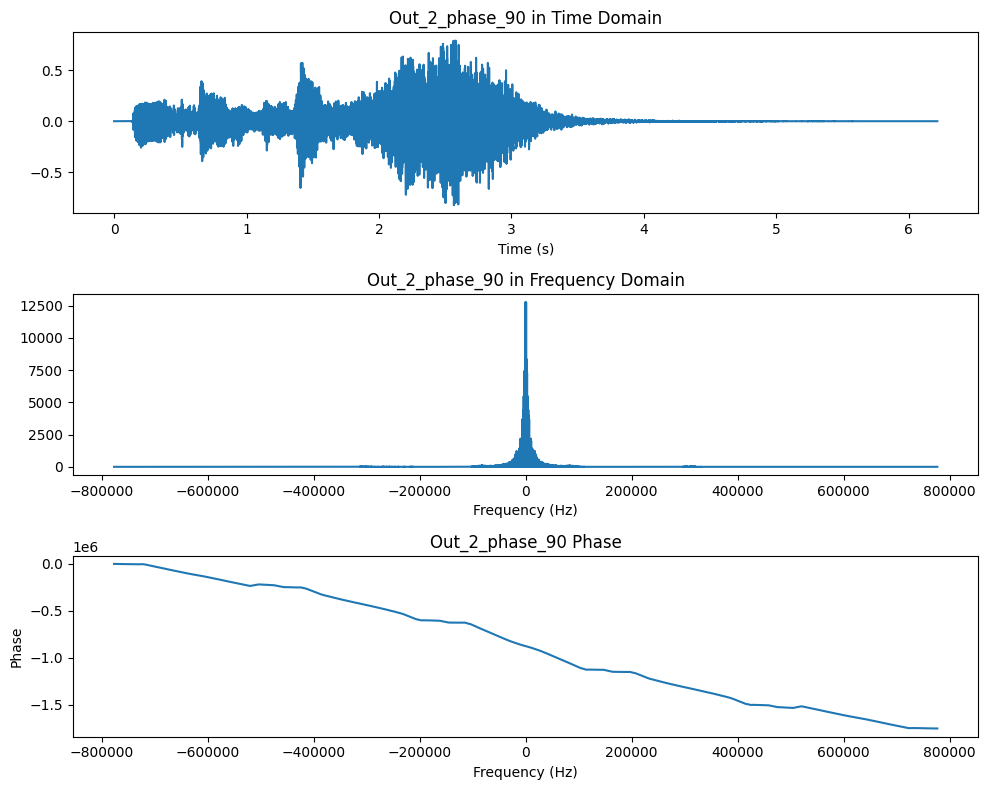

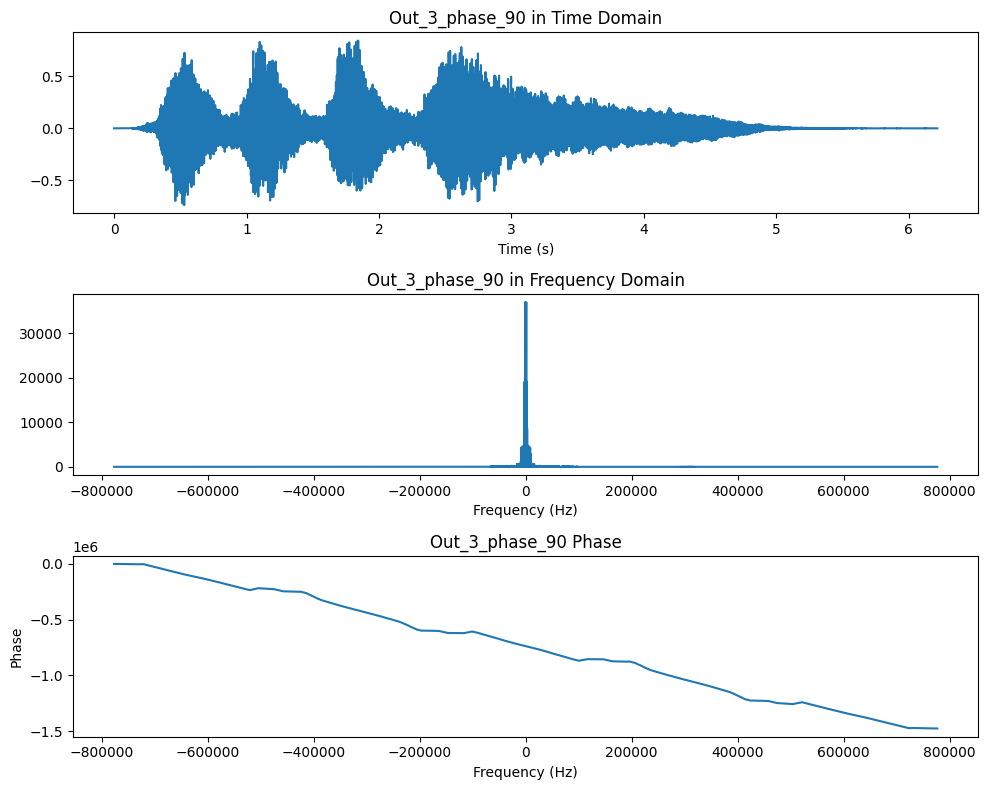

In [12]:
# Phase Shift: 10°
FileNames_phases_10 = ["Out_1_phase_10", "Out_2_phase_10", "Out_3_phase_10"]
Carriers_phase_10 = CarriersPhase(Carrier_frequency_1, Carrier_frequency_2, 10, t)
for i in range(3):
    demodulation(Modulated_Signal, frequency_BandPass, FileNames_phases_10[i], Carriers_phase_10[i], frequency_sampling, i+9, t)

# Phase Shift: 30°
FileNames_phases_30 = ["Out_1_phase_30", "Out_2_phase_30", "Out_3_phase_30"]
Carriers_phase_30 = CarriersPhase(Carrier_frequency_1, Carrier_frequency_2, 30, t)
for i in range(3):
    demodulation(Modulated_Signal, frequency_BandPass, FileNames_phases_30[i], Carriers_phase_30[i], frequency_sampling, i+13, t)

# Phase Shift: 90°
FileNames_phases_90 = ["Out_1_phase_90", "Out_2_phase_90", "Out_3_phase_90"]
Carriers_phase_90 = CarriersPhase(Carrier_frequency_1, Carrier_frequency_2, 90, t)
for i in range(3):
    cutoff = frequency_BandPass if i == 0 else frequency_BandPass2
    demodulation(Modulated_Signal, cutoff, FileNames_phases_90[i], Carriers_phase_90[i], frequency_sampling, i+17, t)


### 10. Demodulation with Frequency Shifts
#### Perform demodulation with local carrier frequencies shifted by 2 Hz and 10 Hz from the original carriers.


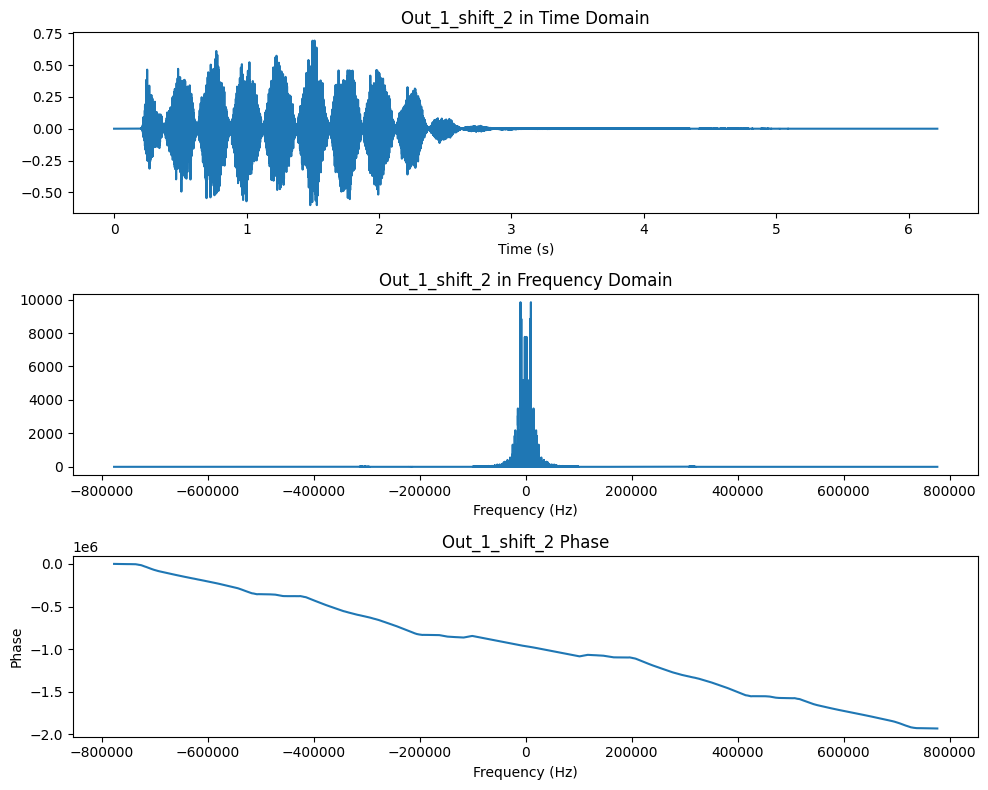

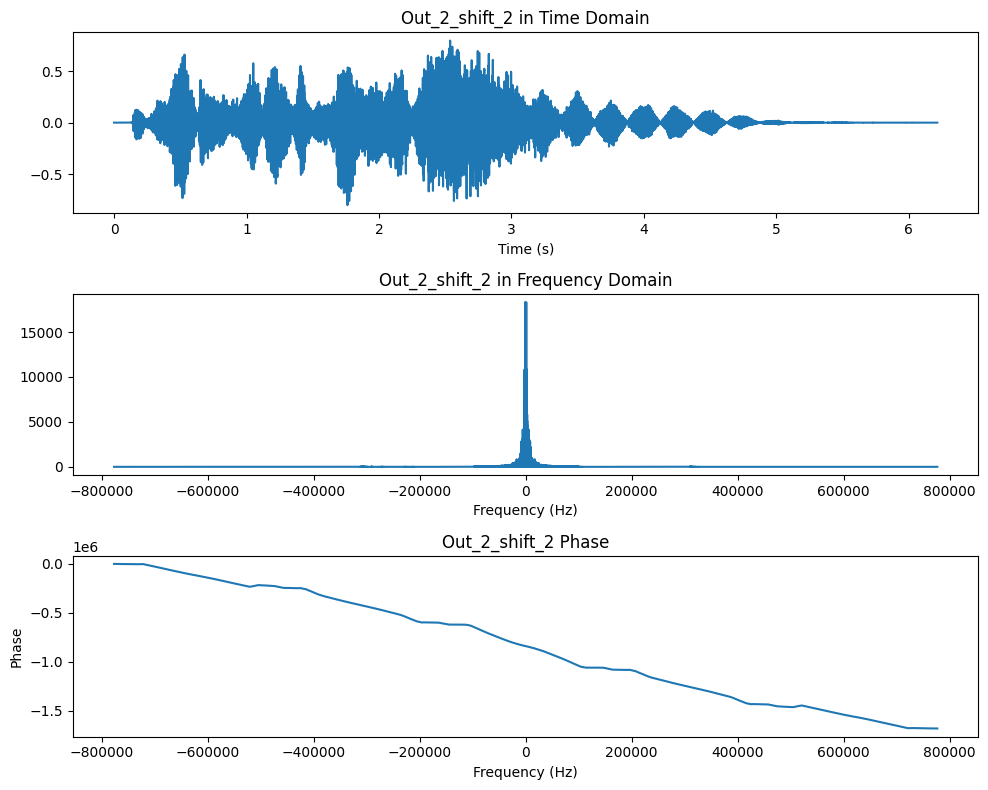

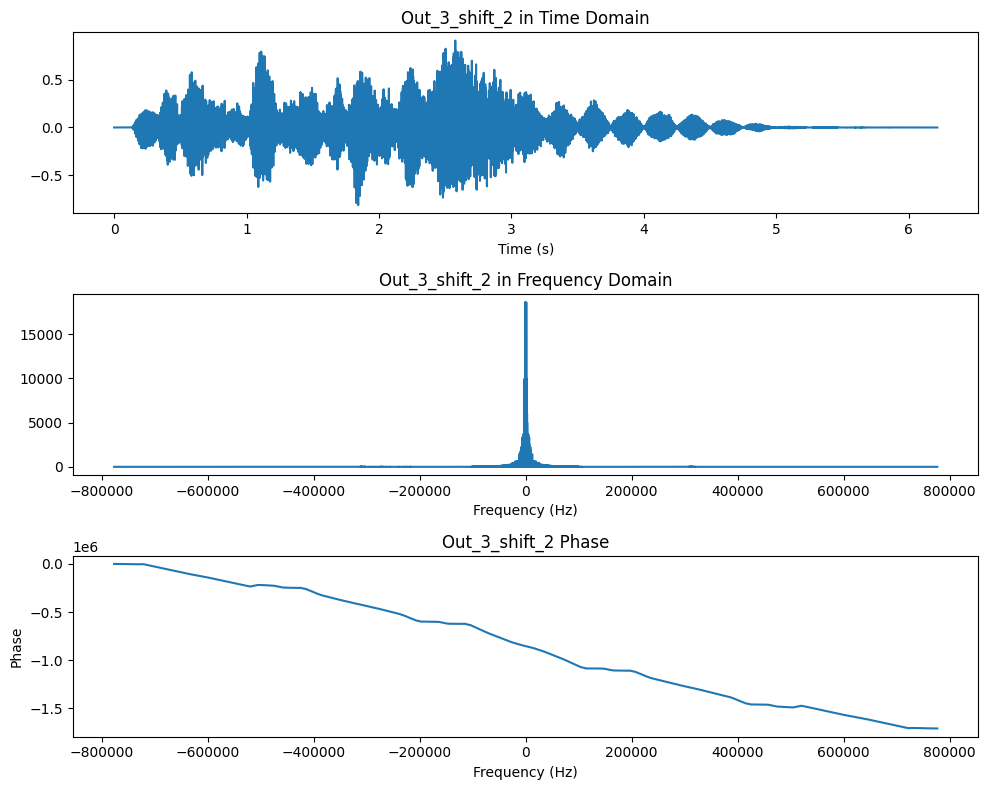

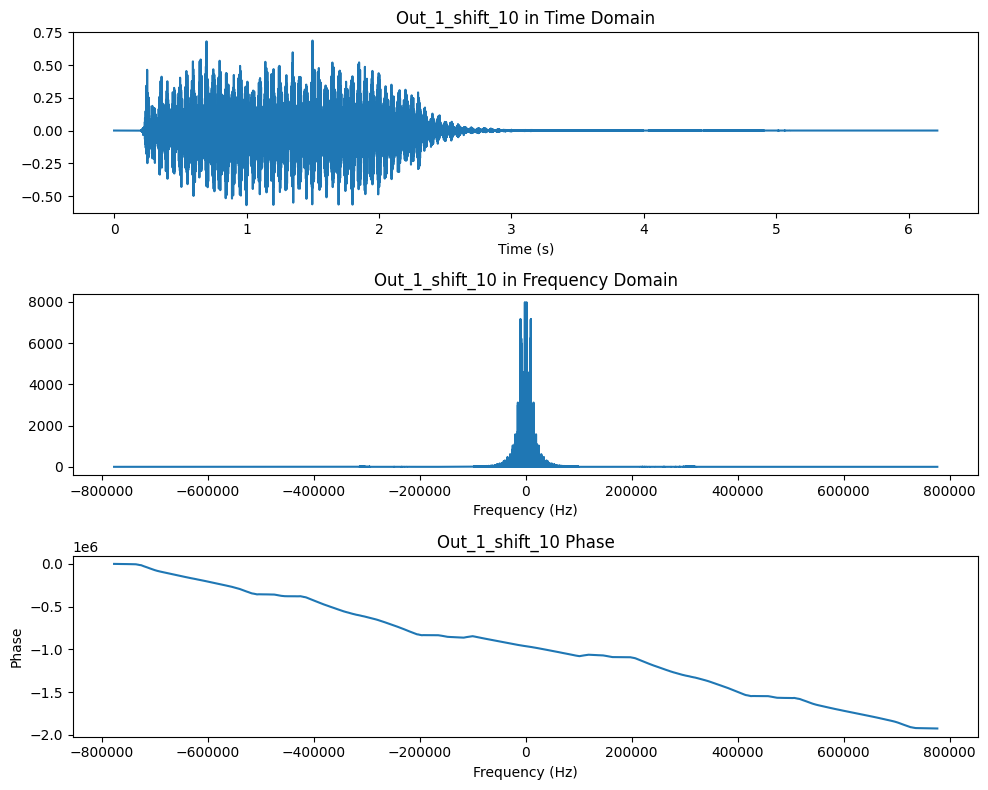

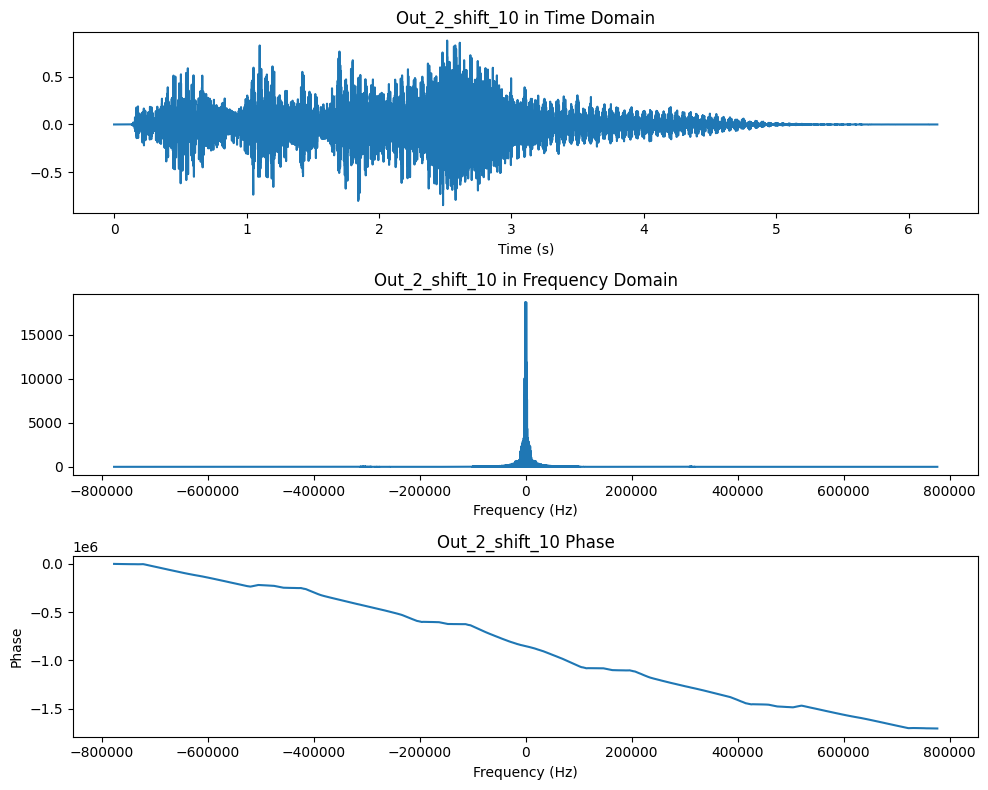

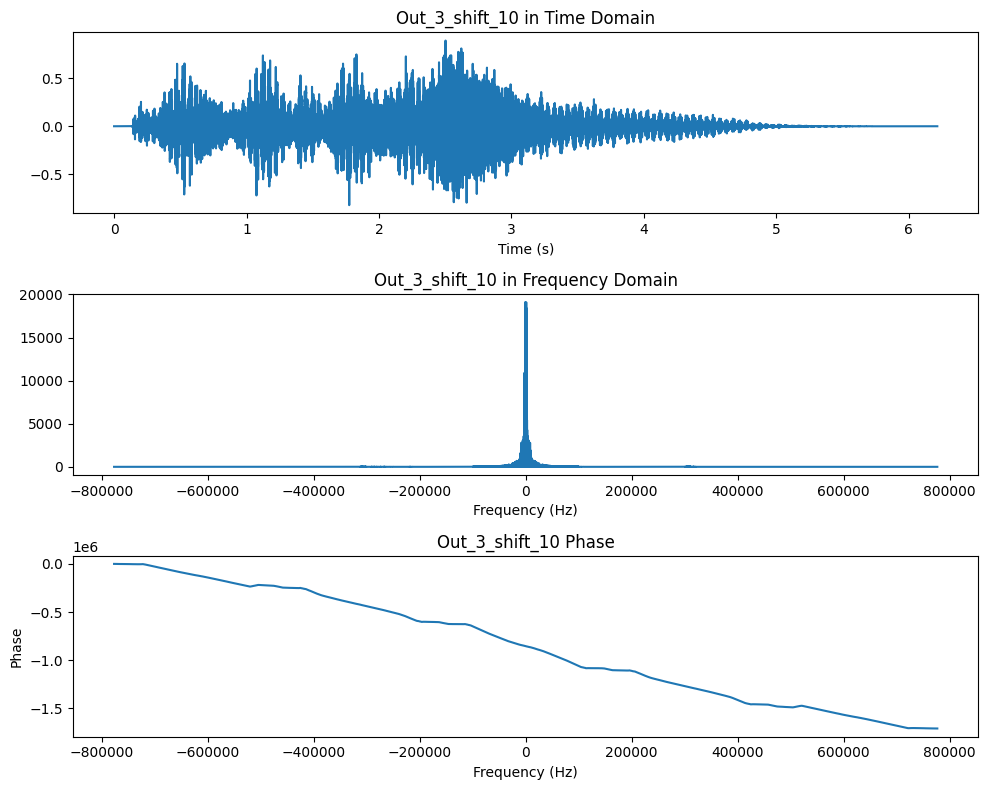

In [13]:
# Frequency shift by 2 Hz
FileNames_shift_2 = ["Out_1_shift_2", "Out_2_shift_2", "Out_3_shift_2"]
Carriers_shift_2 = CarriersDifferentFc(Carrier_frequency_1, Carrier_frequency_2, 2, t)
for i in range(3):
    demodulation(Modulated_Signal, frequency_BandPass, FileNames_shift_2[i], Carriers_shift_2[i], frequency_sampling, i+21, t)

# Frequency shift by 10 Hz
FileNames_shift_10 = ["Out_1_shift_10", "Out_2_shift_10", "Out_3_shift_10"]
Carriers_shift_10 = CarriersDifferentFc(Carrier_frequency_1, Carrier_frequency_2, 10, t)
for i in range(3):
    demodulation(Modulated_Signal, frequency_BandPass, FileNames_shift_10[i], Carriers_shift_10[i], frequency_sampling, i+25, t)


### 12. Signal Quality Analysis
#### Evaluate the quality of the demodulated signals compared to the original signals using metrics like SNR, MSE, and correlation.

### 13. Spectrograms for Time-Frequency Analysis
#### Generate spectrograms to visualize how signal frequencies change over time.

C:\Users\Munsif\AppData\Roaming\Python\Python310\site-packages\matplotlib\axes\_axes.py:7773: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


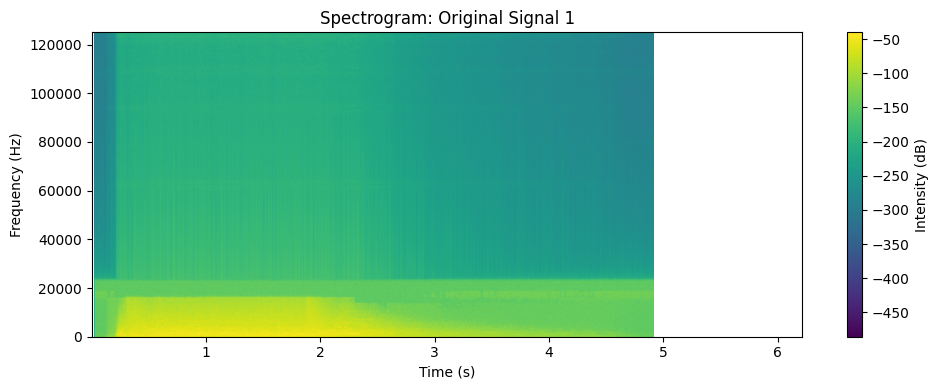

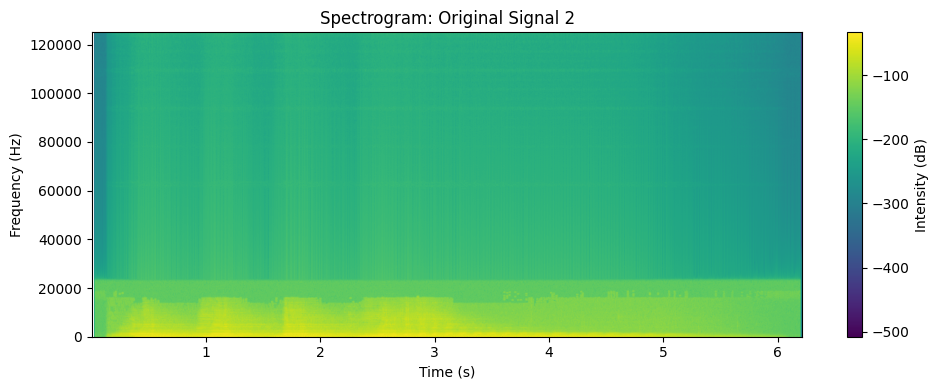

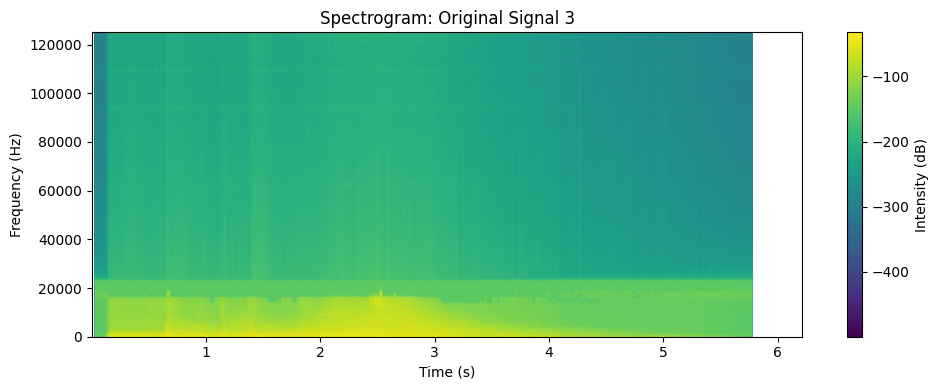

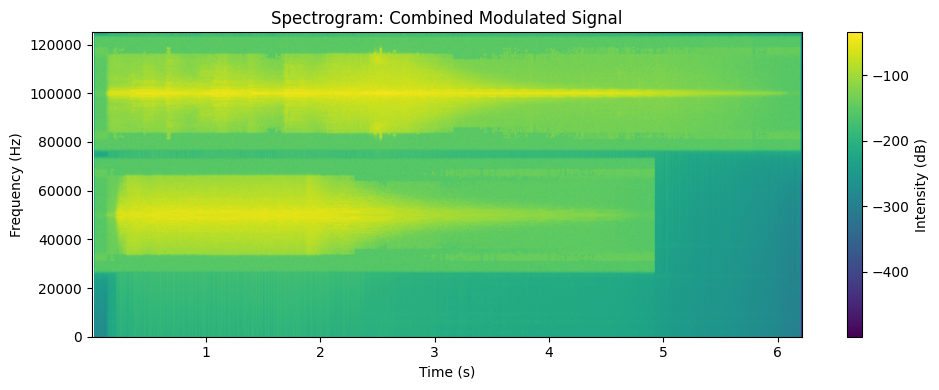

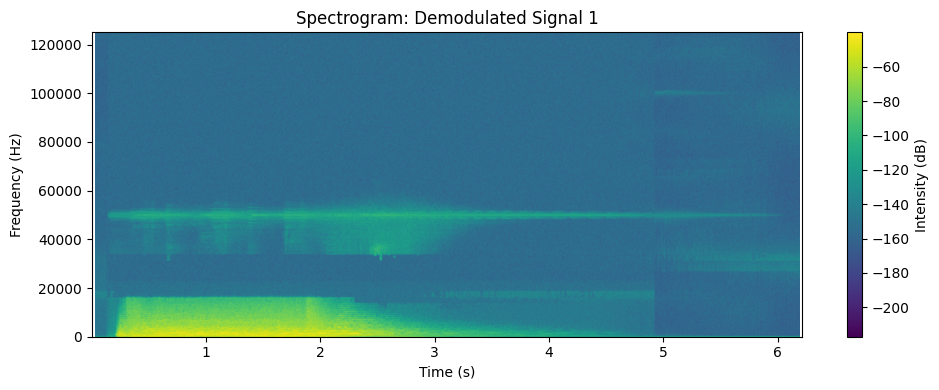

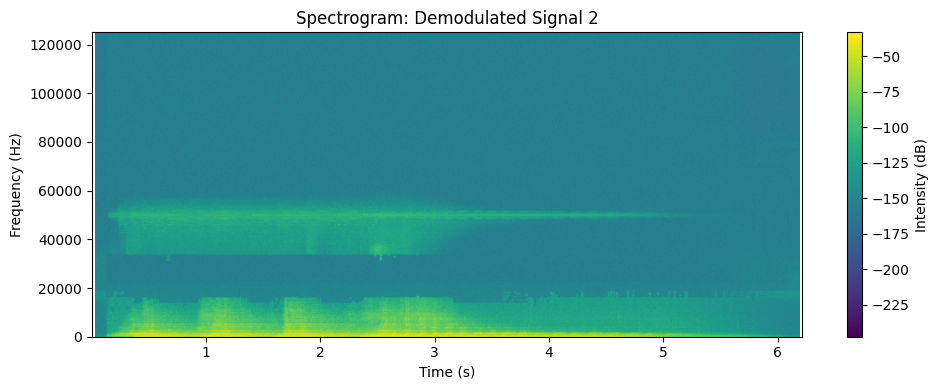

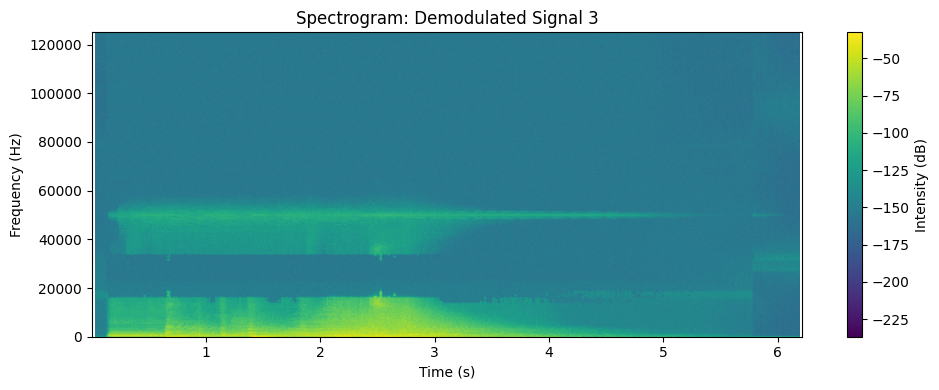

In [14]:
def plot_spectrogram(signal, fs, title):
    plt.figure(figsize=(10, 4))
    
    # Generate spectrogram
    plt.specgram(signal, Fs=fs, NFFT=1024, noverlap=512, cmap='viridis')
    
    plt.title(f'Spectrogram: {title}')
    plt.ylabel('Frequency (Hz)')
    plt.xlabel('Time (s)')
    plt.colorbar(label='Intensity (dB)')
    plt.tight_layout()
    plt.show()

# Plot spectrograms of original signals
plot_spectrogram(signal_1, frequency_sampling, 'Original Signal 1')
plot_spectrogram(signal_2, frequency_sampling, 'Original Signal 2')
plot_spectrogram(signal_3, frequency_sampling, 'Original Signal 3')

# Plot spectrogram of modulated signal
plot_spectrogram(Modulated_Signal, frequency_sampling, 'Combined Modulated Signal')

# Plot spectrograms of demodulated signals
for i, name in enumerate(FileNames):
    demod_signal, _ = librosa.load(f'Output_signals/{name}.wav', sr=frequency_sampling)
    plot_spectrogram(demod_signal, frequency_sampling, f'Demodulated Signal {i+1}')

### 14. 3D Spectrograms for Enhanced Time-Frequency Analysis
#### Generate 3D spectrograms to visualize signal frequencies over time in a more detailed manner.

C:\Users\Munsif\AppData\Local\Temp\ipykernel_8124\1854048382.py:55: RuntimeWarning: divide by zero encountered in log10
  surf = ax.plot_surface(T, F, 10 * np.log10(Sxx), cmap=cm.viridis,
C:\Users\Munsif\AppData\Roaming\Python\Python310\site-packages\mpl_toolkits\mplot3d\proj3d.py:180: RuntimeWarning: invalid value encountered in divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


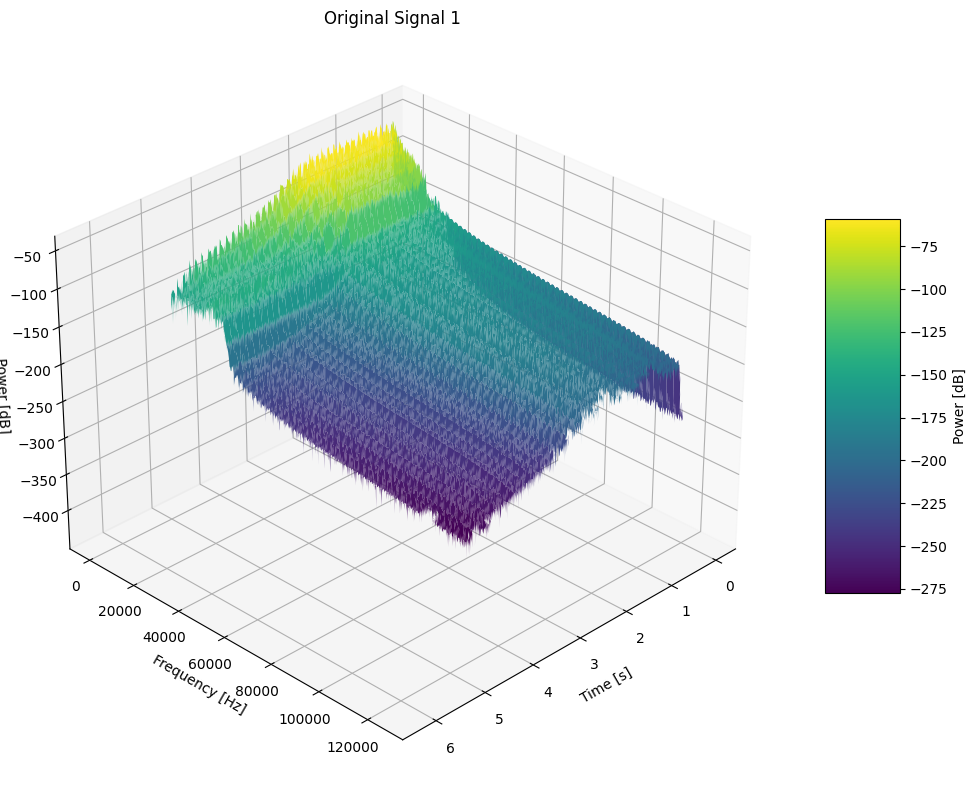

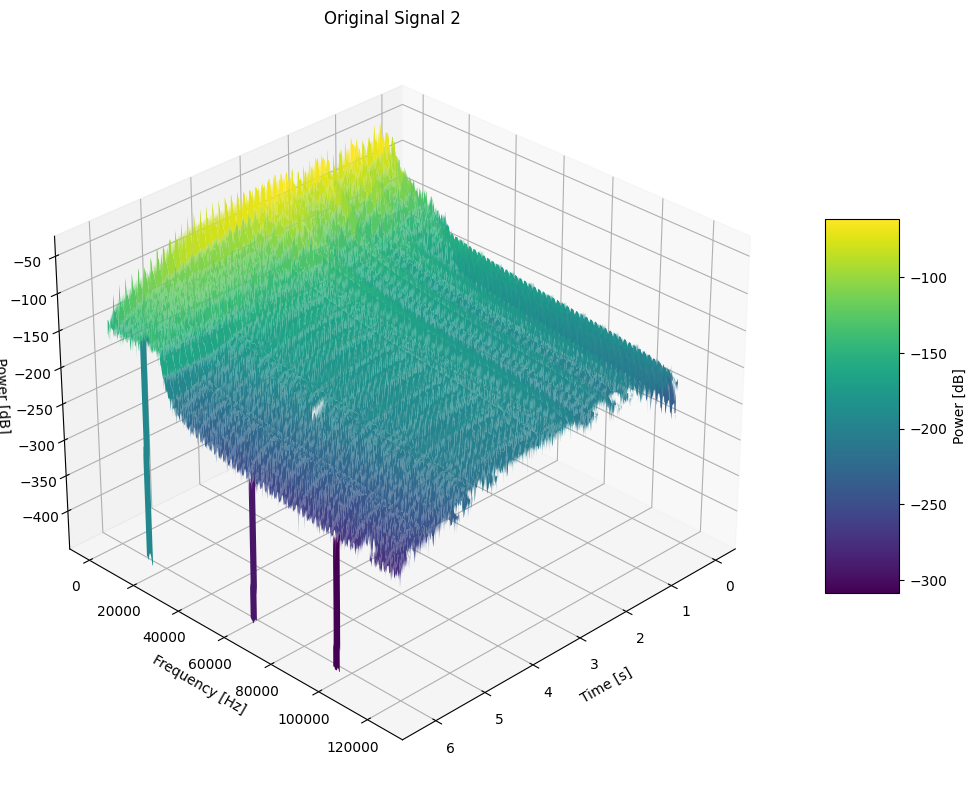

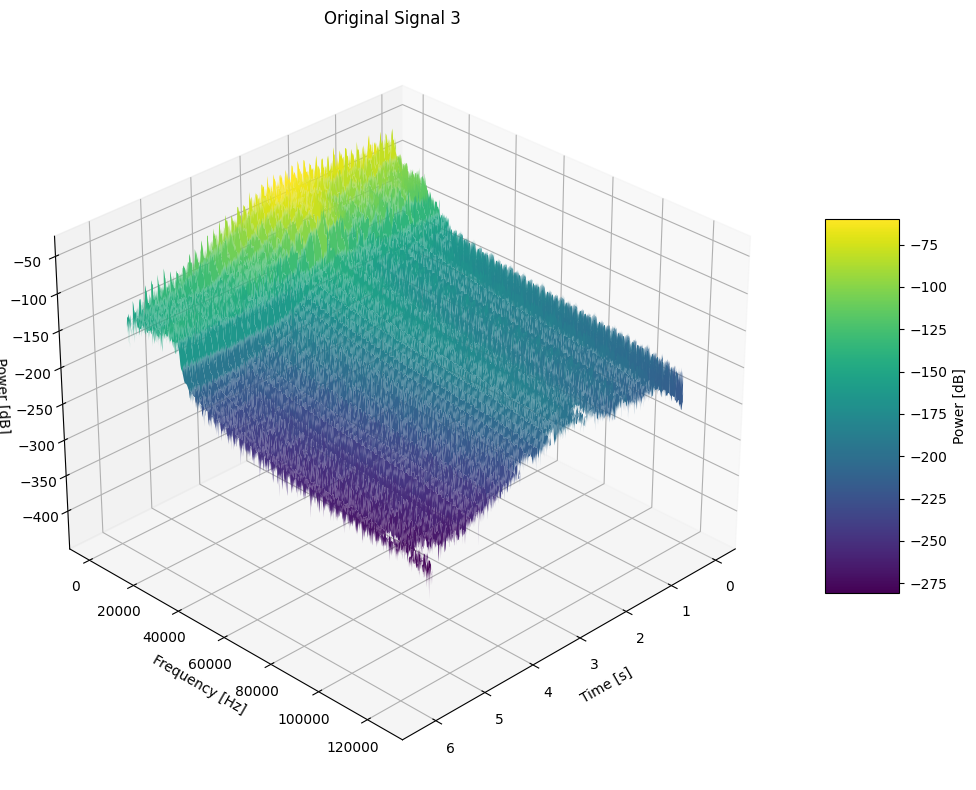

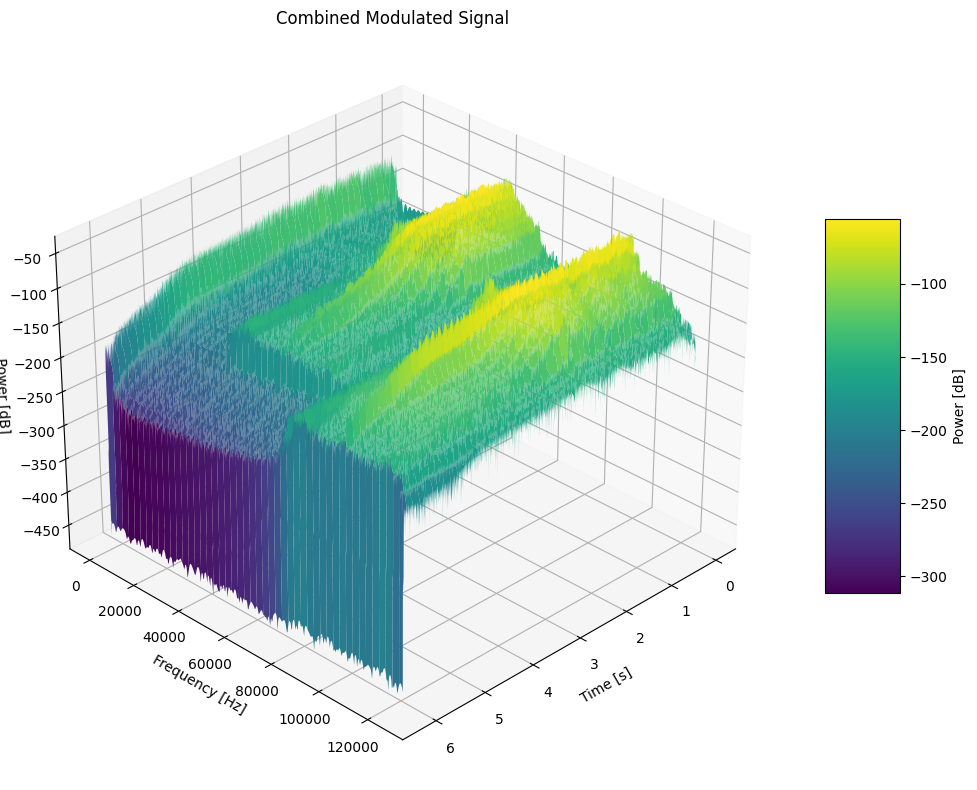

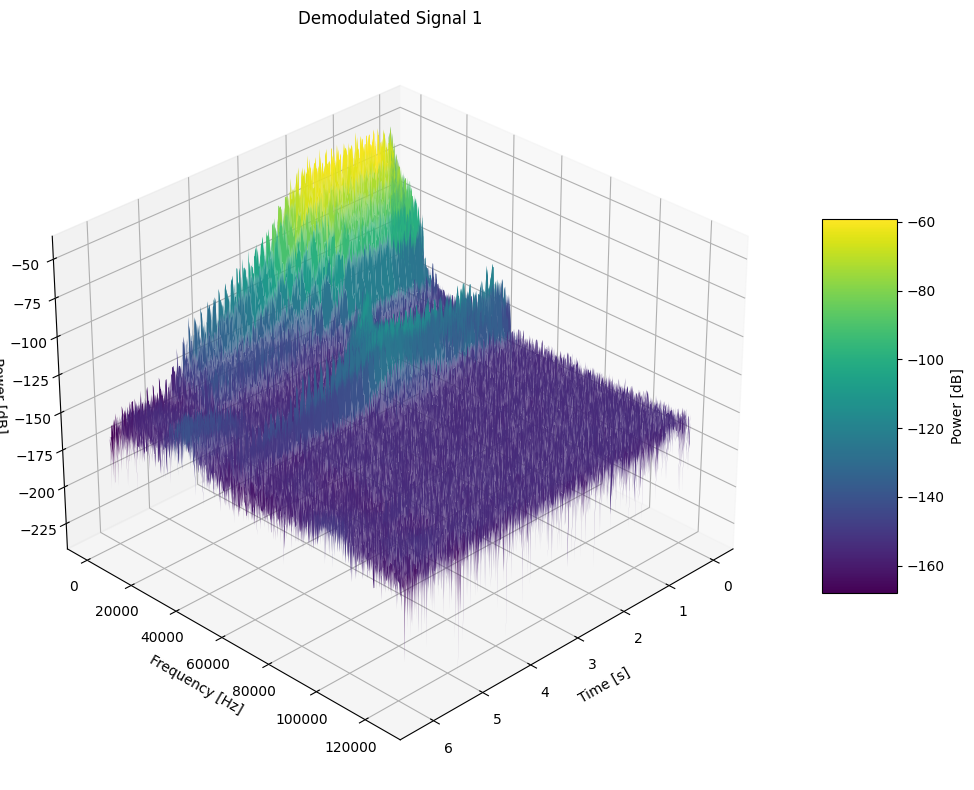

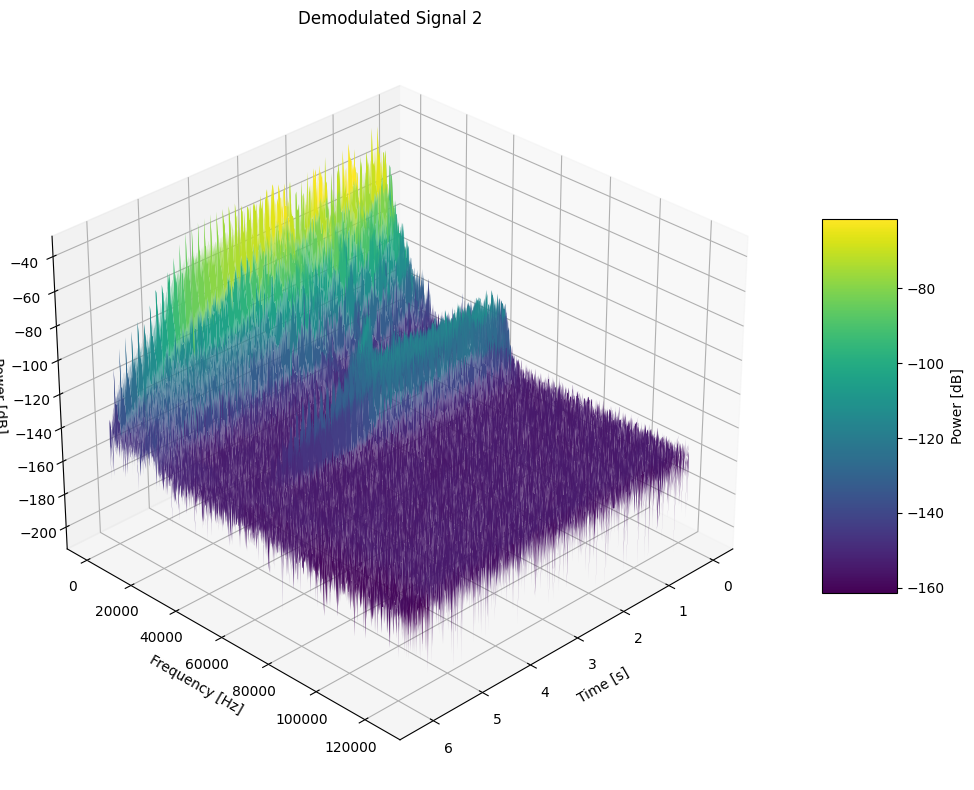

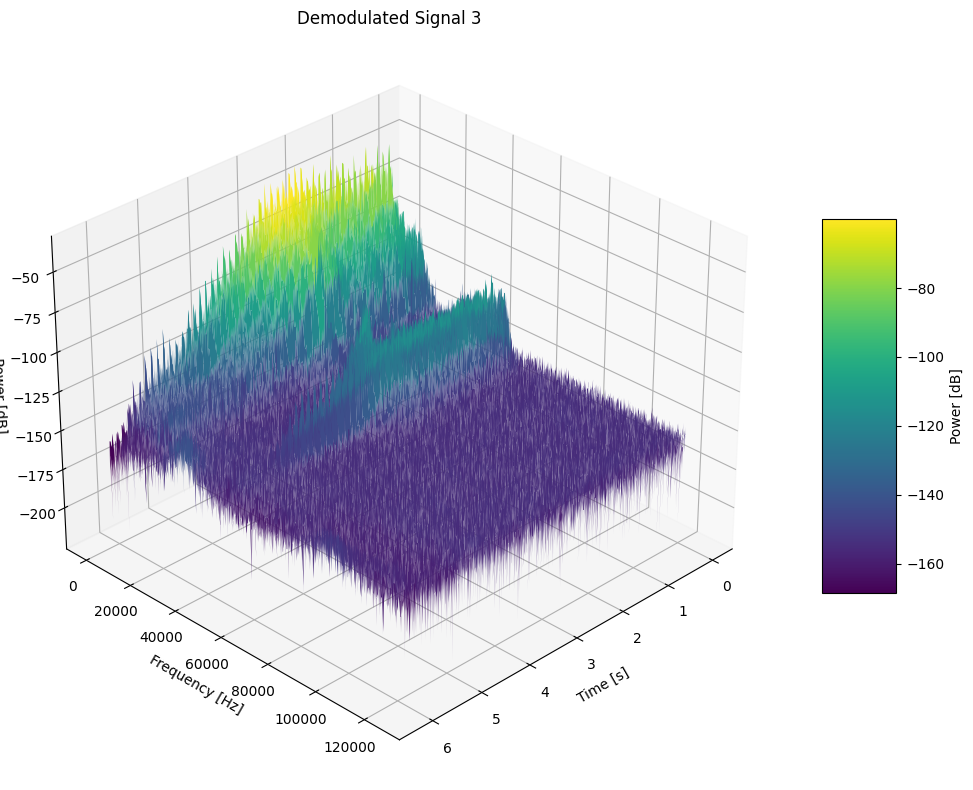

In [15]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

def compute_spectrogram(signal_data, fs, nperseg=1024, noverlap=512):
    """
    Compute the spectrogram of a signal.
    
    Parameters:
    -----------
    signal_data : array_like
        Time series of measurement values
    fs : float
        Sampling frequency of the signal
    nperseg : int, optional
        Length of each segment
    noverlap : int, optional
        Number of points to overlap between segments
    
    Returns:
    --------
    f : ndarray
        Array of sample frequencies
    t : ndarray
        Array of segment times
    Sxx : ndarray
        Spectrogram of the signal
    """
    f, t, Sxx = signal.spectrogram(signal_data, fs=fs, nperseg=nperseg, noverlap=noverlap)
    return f, t, Sxx

def plot_3d_spectrogram(signal_data, fs, title="3D Spectrogram"):
    """
    Create a 3D visualization of the spectrogram.
    
    Parameters:
    -----------
    signal_data : array_like
        Time series of measurement values
    fs : float
        Sampling frequency of the signal
    title : str, optional
        Title for the plot
    """
    # Compute spectrogram
    f, t, Sxx = compute_spectrogram(signal_data, fs)
    
    # Create meshgrid for 3D plotting
    T, F = np.meshgrid(t, f)
    
    # Create figure and 3D axis
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    # Plot the surface
    surf = ax.plot_surface(T, F, 10 * np.log10(Sxx), cmap=cm.viridis,
                          linewidth=0, antialiased=True)
    
    # Customize the view
    ax.view_init(elev=30, azim=45)
    
    # Add labels
    ax.set_xlabel('Time [s]')
    ax.set_ylabel('Frequency [Hz]')
    ax.set_zlabel('Power [dB]')
    ax.set_title(title)
    
    # Add colorbar
    fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5, label='Power [dB]')
    
    plt.tight_layout()
    plt.show()

# Plot 3D spectrograms of original signals
plot_3d_spectrogram(signal_1, frequency_sampling, 'Original Signal 1')
plot_3d_spectrogram(signal_2, frequency_sampling, 'Original Signal 2')
plot_3d_spectrogram(signal_3, frequency_sampling, 'Original Signal 3')

# Plot 3D spectrogram of modulated signal
plot_3d_spectrogram(Modulated_Signal, frequency_sampling, 'Combined Modulated Signal')

# Plot 3D spectrograms of demodulated signals
for i, name in enumerate(FileNames):
    demod_signal, _ = librosa.load(f'Output_signals/{name}.wav', sr=frequency_sampling)
    plot_3d_spectrogram(demod_signal, frequency_sampling, f'Demodulated Signal {i+1}')

### 16. Interactive Audio Player for Signal Comparison
#### Create an interactive interface to play and compare original and demodulated signals.

In [16]:
from IPython.display import Audio, display, HTML

def create_audio_player(signal, fs, title):
    """Create an audio player for the given signal"""
    # Normalize signal for better audio playback
    normalized = signal / np.max(np.abs(signal))
    audio = Audio(data=normalized, rate=fs)
    
    # Create a display widget with title
    return HTML(f"<h4>{title}</h4>"), audio

# Create audio players for original signals
print("Original Signals:")
for i, signal in enumerate([signal_1, signal_2, signal_3]):
    title, player = create_audio_player(signal, frequency_sampling, f"Original Signal {i+1}")
    display(title, player)

# Create audio player for modulated signal
print("\nModulated Signal:")
title, player = create_audio_player(Modulated_Signal, frequency_sampling, "Combined Modulated Signal")
display(title, player)

# Create audio players for demodulated signals
print("\nDemodulated Signals (Standard):")
for i, name in enumerate(FileNames):
    demod_signal, _ = librosa.load(f'Output_signals/{name}.wav', sr=frequency_sampling)
    title, player = create_audio_player(demod_signal, frequency_sampling, f"Demodulated Signal {i+1}")
    display(title, player)

# Create audio players for phase-shifted demodulation (90°)
print("\nDemodulated Signals (90° Phase Shift):")
for i, name in enumerate(FileNames_phases_90):
    demod_signal, _ = librosa.load(f'Output_signals/{name}.wav', sr=frequency_sampling)
    title, player = create_audio_player(demod_signal, frequency_sampling, f"Demodulated Signal {i+1} (90° Phase)")
    display(title, player)

Original Signals:



Modulated Signal:



Demodulated Signals (Standard):



Demodulated Signals (90° Phase Shift):
